<a href="https://colab.research.google.com/github/pranjall702/LPF/blob/main/7aLPF.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

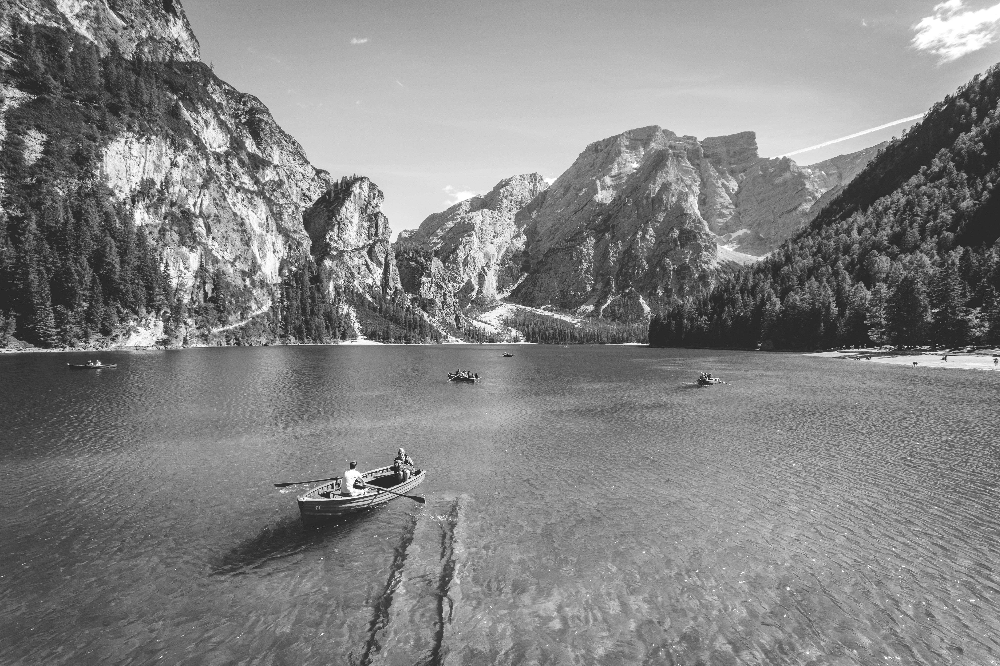

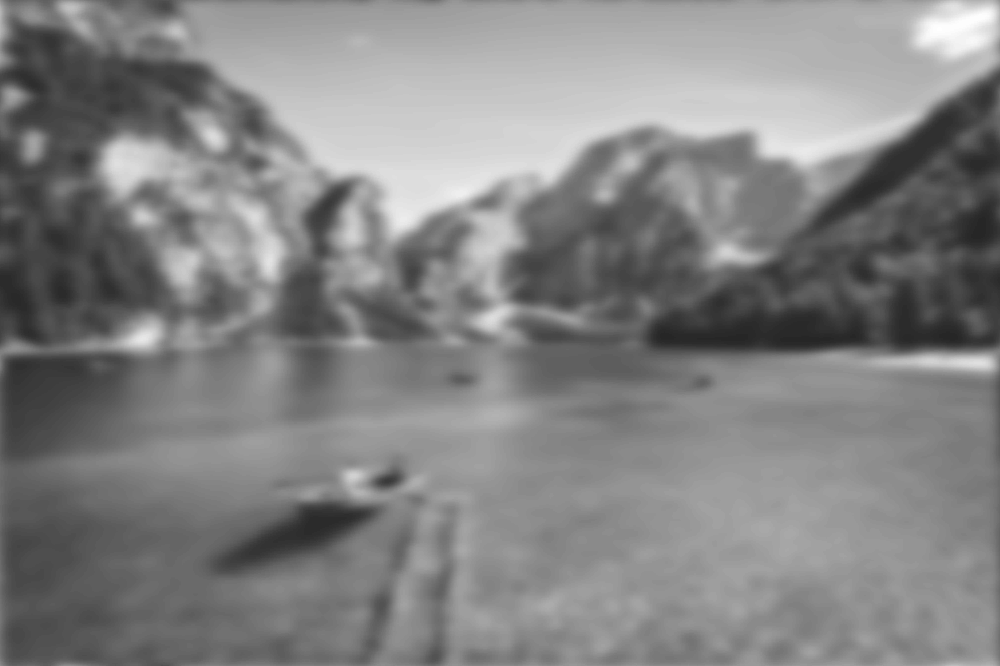

In [10]:
import numpy as np
import cv2
from scipy.fft import fft2, ifft2, fftshift
from google.colab.patches import cv2_imshow

def butterworth_lowpass_filter(shape, cutoff, order):
    """
    Creates a Butterworth low-pass filter.

    Args:
        shape (tuple): Shape of the filter (rows, cols).
        cutoff (int): Cutoff frequency.
        order (int): Filter order.

    Returns:
        numpy.ndarray: Butterworth low-pass filter.
    """
    P, Q = shape
    H = np.zeros((P, Q))
    for u in range(P):
        for v in range(Q):
            D_uv = np.sqrt((u - P/2)**2 + (v - Q/2)**2)
            H[u, v] = 1 / (1 + (D_uv / cutoff)**(2 * order))
    return H

def apply_filter(image, filter):
    """
    Applies a filter to an image using FFT.

    Args:
        image (numpy.ndarray): Input image.
        filter (numpy.ndarray): Filter to apply.

    Returns:
        numpy.ndarray: Filtered image.
    """
    dft = fft2(image)
    dft_shifted = fftshift(dft)
    filtered_dft = dft_shifted * filter
    filtered_dft_shifted = np.fft.ifftshift(filtered_dft)
    filtered_image = np.abs(ifft2(filtered_dft_shifted))
    return filtered_image

# Define image path variable
image_path ='/content/pietro-de-grandi-T7K4aEPoGGk-unsplash.jpg'

# Load the image
image = cv2.imread(image_path, 0)  # Load in grayscale

# Check if image loading was successful
if image is None:
    print(f"Error: Could not load image from {image_path}. Please check the file path and permissions.")
else:
    # Define filter parameters
    cutoff = 30  # Cutoff frequency
    order = 2    # Filter order

    # Create the Butterworth filter
    filter = butterworth_lowpass_filter(image.shape, cutoff, order)

    # Apply the filter to the image
    filtered_image = apply_filter(image, filter)

    # Display the original and filtered images
    cv2_imshow(image)
    cv2_imshow(filtered_image)
    cv2.waitKey(0)
    cv2.destroyAllWindows()